In [ ]:
# Install libraries
#!pip install osmnx geopandas pandas requests descartes contextily

In [1]:
import numpy as np
import pandas as pd 
import geopandas as gpd
import matplotlib.pyplot as plt
import osmnx as ox
import networkx as nx
from descartes import PolygonPatch
from shapely.geometry import Point, Polygon, MultiPolygon, LineString
from tqdm.auto import tqdm
import shapely.speedups
shapely.speedups.enable() 
import warnings
warnings.filterwarnings('ignore')
from matplotlib.patches import PathPatch
from matplotlib.path import Path

C:\Users\LENOVO\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.12_qbz5n2kfra8p0\LocalCache\local-packages\Python312\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
C:\Users\LENOVO\AppData\Local\Temp\ipykernel_8156\2715854114.py:11: DeprecationWarning: This function has no longer any effect, and will be removed in a future release. Starting with Shapely 2.0, equivalent speedups are always available
  shapely.speedups.enable()


In [2]:
PLACE_NAME = 'Rome, Italy'
name = 'Rome'
grid_size = 500

epsg:4326
EPSG:32633


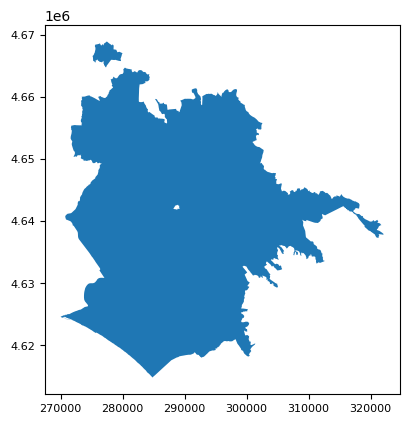

<class 'shapely.geometry.multipolygon.MultiPolygon'>


In [6]:
city = ox.geocode_to_gdf(PLACE_NAME)
print(city.crs)
# changing CRS for grid division
city = ox.project_gdf(city) 
print(city.crs)

# Plot and store the axis object
ax = city.plot()

# Customize the font size of the tick labels on the axes
ax.tick_params(axis='both', which='major', labelsize=8)

# Display the plot
plt.show()

# Print the type of geometry for your information
geometry = city['geometry'].iloc[0]
print(type(geometry))

In [7]:
#save geometry
city.to_file(f"D:/charging_stations/task2/map/{name}.shp")

# Division into grid

In [8]:
geometry_cut = ox.utils_geo._quadrat_cut_geometry(geometry, quadrat_width=grid_size) #500 Meter grid
print(type(geometry_cut))
polylist = [poly for poly in geometry_cut.geoms]

<class 'shapely.geometry.multipolygon.MultiPolygon'>


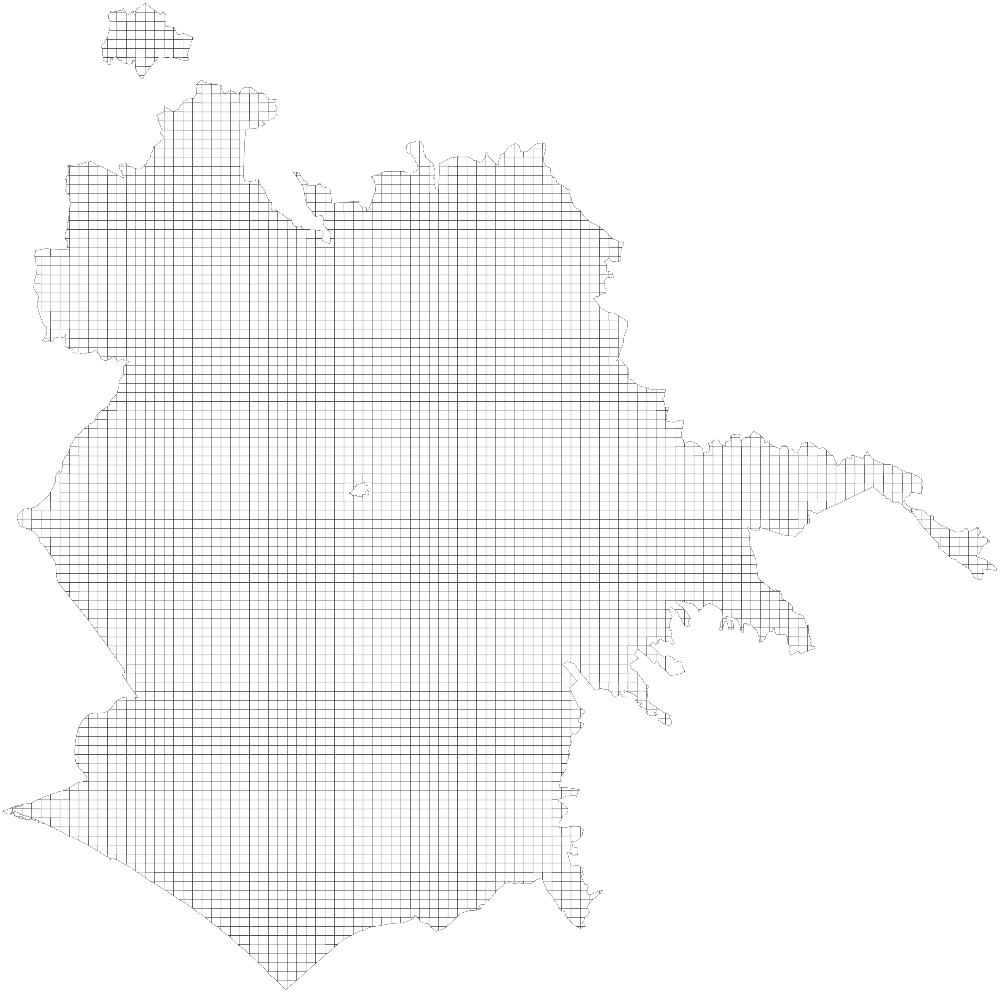

In [9]:
import shapely.geometry as sg
polylist = [poly for poly in geometry_cut.geoms]
# plot city
west, south, east, north = city.unary_union.bounds

# Manual patch creation
fig, ax = plt.subplots(figsize=(40, 40))
for polygon in geometry_cut.geoms:
    if isinstance(polygon, sg.Polygon) and not polygon.is_empty:
        verts = np.array(polygon.exterior.coords)
        codes = np.full(len(verts), Path.LINETO)
        codes[0] = Path.MOVETO
        codes[-1] = Path.CLOSEPOLY
        path = Path(verts, codes)
        patch = PathPatch(path, facecolor='white', edgecolor='black', alpha=0.5)
        ax.add_patch(patch)

ax.set_xlim(west, east)
ax.set_ylim(south, north)
ax.axis('off')
plt.show()

In [10]:
city_polyframe = gpd.GeoDataFrame(geometry=polylist)
city_polyframe.crs = city.crs
print(city_polyframe.crs)
city_polyframe.head()

EPSG:32633


,geometry
0,"POLYGON ((270025.024 4624611.066, 270085.665 4..."
1,"POLYGON ((270329.104 4624710.080, 270335.189 4..."
2,"POLYGON ((270520.617 4624792.210, 270527.065 4..."
3,"POLYGON ((271016.211 4624710.080, 271016.211 4..."
4,"POLYGON ((270862.697 4624213.061, 270867.628 4..."


(5109535.004510657, 5182128.295160213)

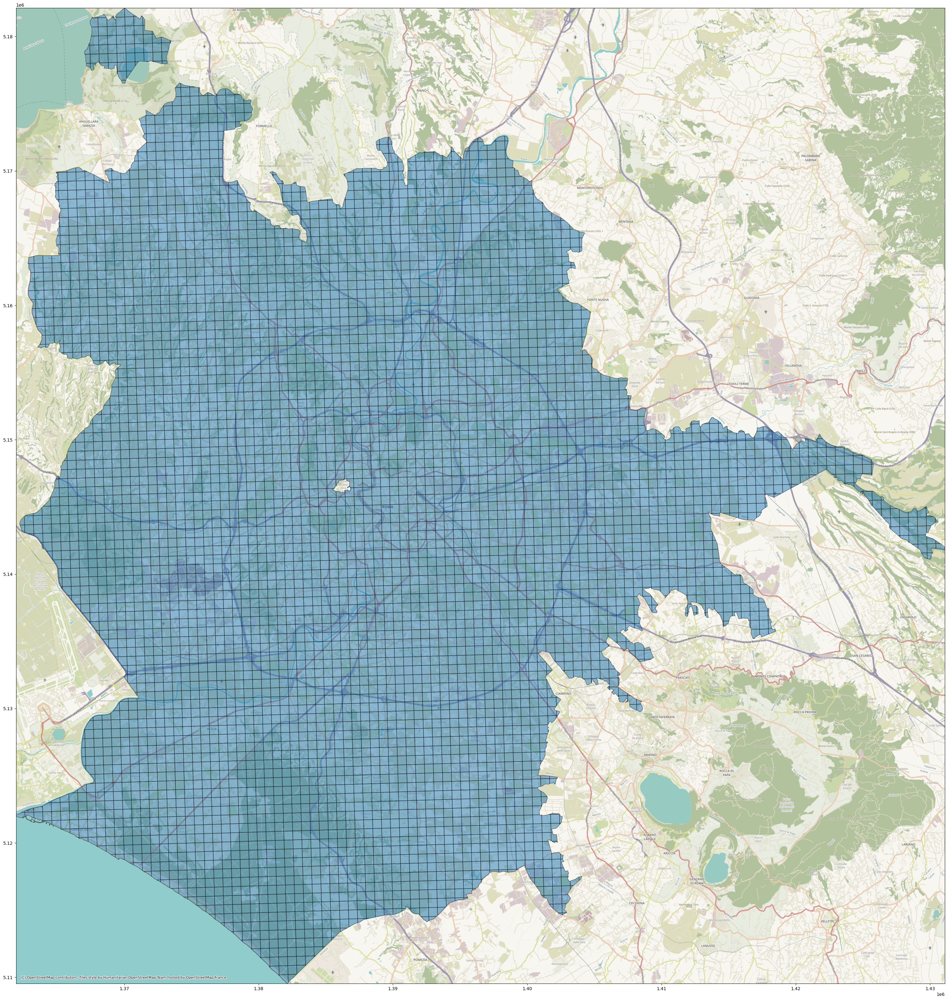

In [11]:
import contextily as ctx
# ctx uses epsg:3857ax = city.plot()
polyframe_3857 = city_polyframe.to_crs(epsg=3857)
west, south, east, north = polyframe_3857.unary_union.bounds

ax = polyframe_3857.plot(figsize=(40,40), alpha=0.5, edgecolor='k')
ctx.add_basemap(ax, zoom=13)
ax.set_xlim(west, east)
ax.set_ylim(south, north)

# POIs

In [12]:
city_polyframe_lat_long = ox.project_gdf(city_polyframe, to_latlong=True) #Changing CRS to (Lat, long)
city_polyframe_lat_long.head()

,geometry
0,"POLYGON ((12.23447 41.74005, 12.23519 41.74020..."
1,"POLYGON ((12.23808 41.74102, 12.23815 41.74106..."
2,"POLYGON ((12.24035 41.74182, 12.24043 41.74184..."
3,"POLYGON ((12.24633 41.74122, 12.24646 41.73832..."
4,"POLYGON ((12.24468 41.73671, 12.24474 41.73667..."


## EV station

In [13]:
EV_stations = ox.geometries_from_place(
    PLACE_NAME,
    {"amenity": "charging_station"},
)

In [14]:
EV_stations.head()

amenity amperage capacity operator voltage  \
element_type osmid                                                             
node         1165400895  charging_station       16        3     Atac     230   
             1165405085  charging_station       16      NaN     ATAC     230   
             1172676847  charging_station       16        2     Atac     230   
             1186372344  charging_station       16      NaN      NaN     230   
             1189767791  charging_station       16      NaN     Atac     230   

                                          geometry brand brand:wikidata  \
element_type osmid                                                        
node         1165400895  POINT (12.47446 41.89705)   NaN            NaN   
             1165405085  POINT (12.46880 41.90899)   NaN            NaN   
             1172676847  POINT (12.47263 41.92962)   NaN            NaN   
             1186372344  POINT (12.51255 41.90178)   NaN            NaN   
             1189767791  POINT (12.51310 41.92313)   NaN            NaN   

                        brand:wikipedia name  ... socket:chademo:current  \
element_type osmid                            ...                          
node         1165400895             NaN  NaN  ...                    NaN   
             1165405085             NaN  NaN  ...                    NaN   
             1172676847             NaN  NaN  ...                    NaN   
             1186372344             NaN  NaN  ...                    NaN   
             1189767791             NaN  NaN  ...                    NaN   

                        socket:chademo:output socket:chademo:voltage  \
element_type osmid                                                     
node         1165400895                   NaN                    NaN   
             1165405085                   NaN                    NaN   
             1172676847                   NaN                    NaN   
             1186372344                   NaN                    NaN   
             1189767791                   NaN                    NaN   

                        socket:type2:output socket:type2_combo  \
element_type osmid                                               
node         1165400895                 NaN                NaN   
             1165405085                 NaN                NaN   
             1172676847                 NaN                NaN   
             1186372344                 NaN                NaN   
             1189767791                 NaN                NaN   

                        socket:type2_combo:output socket:type3a  \
element_type osmid                                                
node         1165400895                       NaN           NaN   
             1165405085                       NaN           NaN   
             1172676847                       NaN           NaN   
             1186372344                       NaN           NaN   
             1189767791                       NaN           NaN   

                        socket:type3a:output nodes surface  
element_type osmid                                          
node         1165400895                  NaN   NaN     NaN  
             1165405085                  NaN   NaN     NaN  
             1172676847                  NaN   NaN     NaN  
             1186372344                  NaN   NaN     NaN  
             1189767791                  NaN   NaN     NaN  

[5 rows x 63 columns]

Text(0.5, 1.0, 'Rome EV stations')

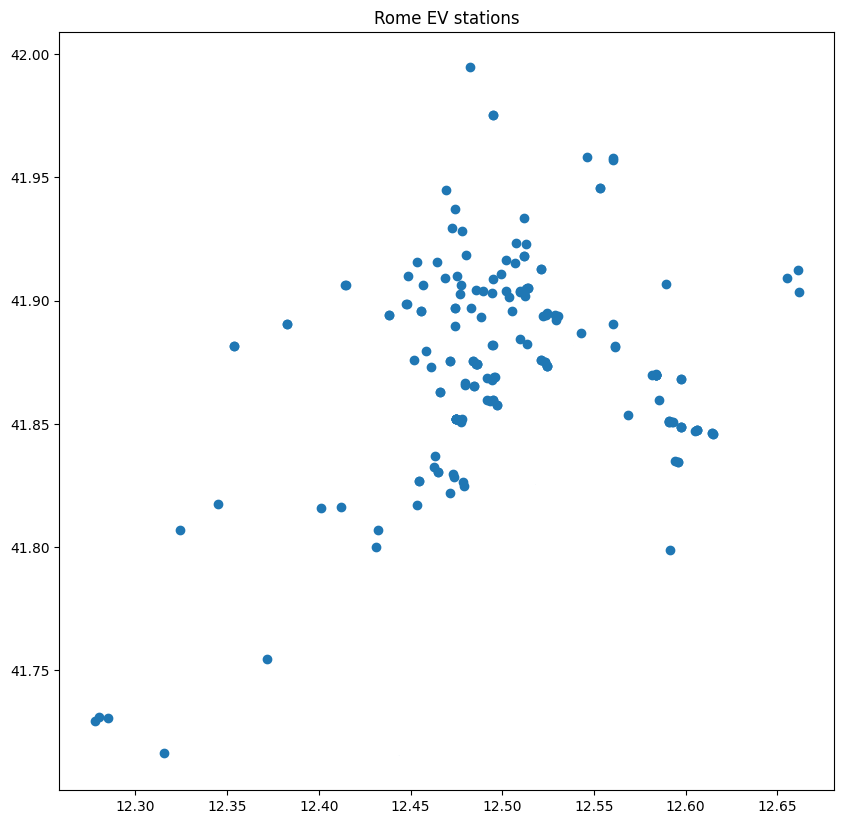

In [15]:
#plot EV stations geo data
EV_stations.plot(figsize=(10,10))
plt.title("Rome EV stations")

Text(0.5, 1.0, 'Rome EV stations')

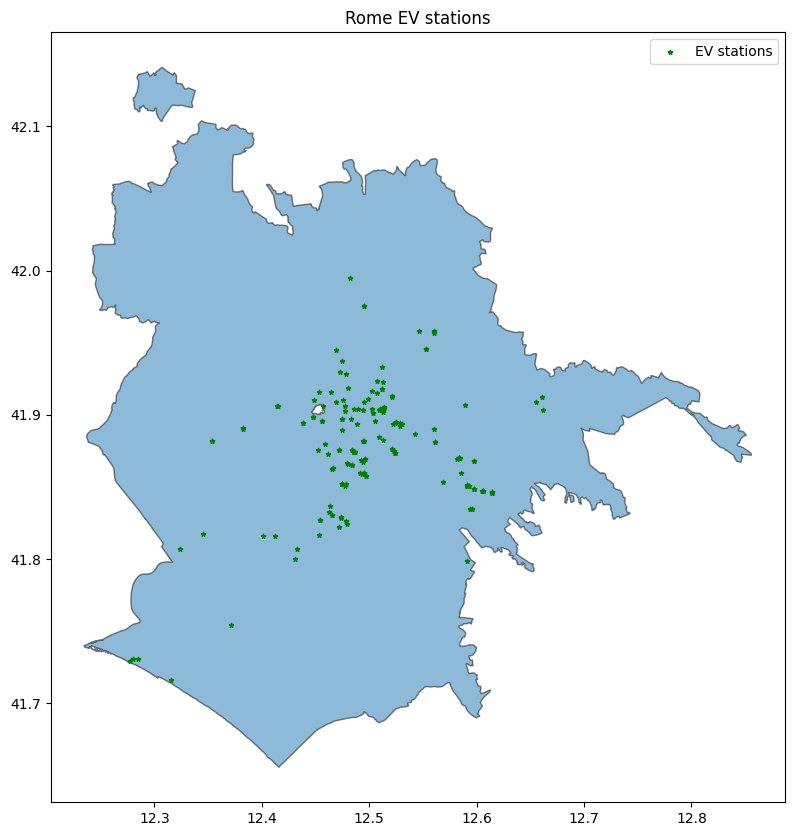

In [16]:
fig, ax = plt.subplots(figsize=(10,10))
ox.project_gdf(city, to_latlong=True).plot(ax =ax, alpha=0.5, edgecolor='k')
EV_stations.plot(ax=ax, color='green', marker='*', markersize=10)
#add legend
plt.legend(['EV stations'])
plt.title("Rome EV stations")

In [17]:
#intersection of points and polygons
import shapely.speedups
shapely.speedups.enable() 

masks_EV = []
for i in tqdm(range(0,city_polyframe.shape[0])):
    pip_mask = EV_stations.within(city_polyframe_lat_long.loc[i, 'geometry']) 
    masks_EV.append(pip_mask)

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_8156\3985573752.py:3: DeprecationWarning: This function has no longer any effect, and will be removed in a future release. Starting with Shapely 2.0, equivalent speedups are always available
  shapely.speedups.enable()
100%|██████████| 5649/5649 [00:00<00:00, 10810.49it/s]


In [18]:
# create a new geodataframe with mask EV stations 
EV_stations_masked = gpd.GeoDataFrame()
for i in tqdm(range(0,city_polyframe.shape[0])):
    EV_stations_masked = pd.concat([EV_stations_masked, EV_stations[masks_EV[i]][['geometry']]], ignore_index=True)

100%|██████████| 5649/5649 [00:04<00:00, 1249.41it/s]


In [19]:
rome_polyframe_lat_long_new = city_polyframe_lat_long.copy()
rome_polyframe_lat_long_new['EV_stations_counts'] = 0
rome_polyframe_lat_long_new['EV_stations_geomery'] = 0

In [20]:
for i in tqdm(range(0,rome_polyframe_lat_long_new.shape[0])):
    rome_polyframe_lat_long_new.loc[i, 'EV_stations_counts'] = EV_stations[masks_EV[i]].shape[0]
    rome_polyframe_lat_long_new.loc[i, 'EV_stations_geomery'] = str(EV_stations[masks_EV[i]][['geometry']].values.tolist())

  0%|          | 0/5649 [00:00<?, ?it/s]C:\Users\LENOVO\AppData\Local\Temp\ipykernel_8156\862076190.py:3: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[]' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  rome_polyframe_lat_long_new.loc[i, 'EV_stations_geomery'] = str(EV_stations[masks_EV[i]][['geometry']].values.tolist())
100%|██████████| 5649/5649 [00:06<00:00, 864.79it/s]


In [21]:
#How many EV stations in each grid
rome_polyframe_lat_long_new['EV_stations_counts'].value_counts()
#Percentage of EV stations in each grid
rome_polyframe_lat_long_new['EV_stations_counts'].value_counts() / rome_polyframe_lat_long_new.shape[0]

EV_stations_counts
0    0.981413
1    0.010975
2    0.004780
3    0.001593
5    0.000531
9    0.000177
8    0.000177
6    0.000177
4    0.000177
Name: count, dtype: float64

In [22]:
rome_polyframe_lat_long_new.head(5)

,geometry,EV_stations_counts,EV_stations_geomery
0,"POLYGON ((12.23447 41.74005, 12.23519 41.74020...",0,[]
1,"POLYGON ((12.23808 41.74102, 12.23815 41.74106...",0,[]
2,"POLYGON ((12.24035 41.74182, 12.24043 41.74184...",0,[]
3,"POLYGON ((12.24633 41.74122, 12.24646 41.73832...",0,[]
4,"POLYGON ((12.24468 41.73671, 12.24474 41.73667...",0,[]


## Population data visualize and add to each grid

In [23]:
df_pop = pd.read_csv("D:/charging_stations/task2/dataset/ita_general_2020.csv")
gdf = gpd.GeoDataFrame(df_pop, geometry=gpd.points_from_xy(df_pop.longitude, df_pop.latitude))

In [24]:
df_pop.head()

,longitude,latitude,ita_general_2020
0,6.215694,48.000139,1.061017
1,6.216250,48.000139,1.061017
2,6.216528,48.000139,1.061017
3,6.243750,48.000139,0.831058
4,6.244028,48.000139,0.831058


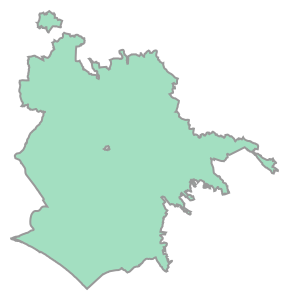

In [25]:
#extract population data for Rome
city.geometry[0]

In [26]:
# change crs to lat long
city_lat_long = ox.project_gdf(city, to_latlong=True)
pip_mask = gdf.within(city_lat_long.loc[0, 'geometry'])

In [27]:
rome_pop_gdf = gdf.loc[pip_mask]

<Axes: >

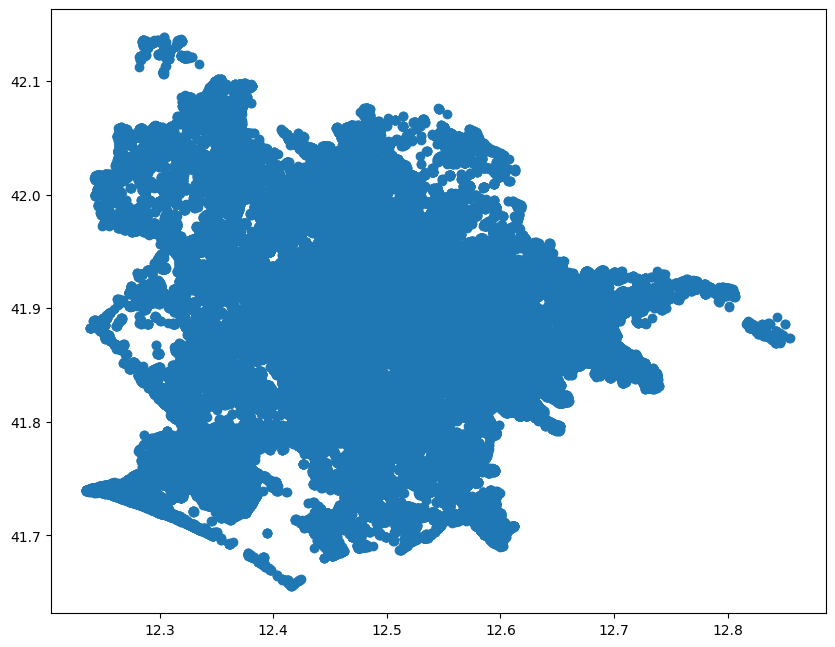

In [28]:
#plot population data with cmap
rome_pop_gdf.plot(figsize=(10,10))

In [121]:
rome_pop_gdf.to_csv(f"D:/charging_stations/task2/dataset/{name}-population.csv")

In [29]:
# population for each grid
masks_pop = []
for i in tqdm(range(0,city_polyframe_lat_long.shape[0])):
    pip_mask = rome_pop_gdf.within(city_polyframe_lat_long.loc[i, 'geometry'])
    masks_pop.append(pip_mask)

100%|██████████| 5649/5649 [01:41<00:00, 55.53it/s]


In [30]:
pop_grid = []
for i in range(0,city_polyframe_lat_long.shape[0]):
    pop_grid.append(rome_pop_gdf.loc[masks_pop[i]].ita_general_2020.mean())

In [31]:
pop_grid = np.nan_to_num(pop_grid)

In [32]:
rome_polyframe_lat_long_new['population'] = pop_grid
rome_polyframe_lat_long_new.head()

,geometry,EV_stations_counts,EV_stations_geomery,population
0,"POLYGON ((12.23447 41.74005, 12.23519 41.74020...",0,[],1.876362
1,"POLYGON ((12.23808 41.74102, 12.23815 41.74106...",0,[],1.394988
2,"POLYGON ((12.24035 41.74182, 12.24043 41.74184...",0,[],1.531297
3,"POLYGON ((12.24633 41.74122, 12.24646 41.73832...",0,[],1.561379
4,"POLYGON ((12.24468 41.73671, 12.24474 41.73667...",0,[],0.000000


C:\Users\LENOVO\AppData\Local\Temp\ipykernel_8156\3781440584.py:9: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  plt.legend(['EV stations'])


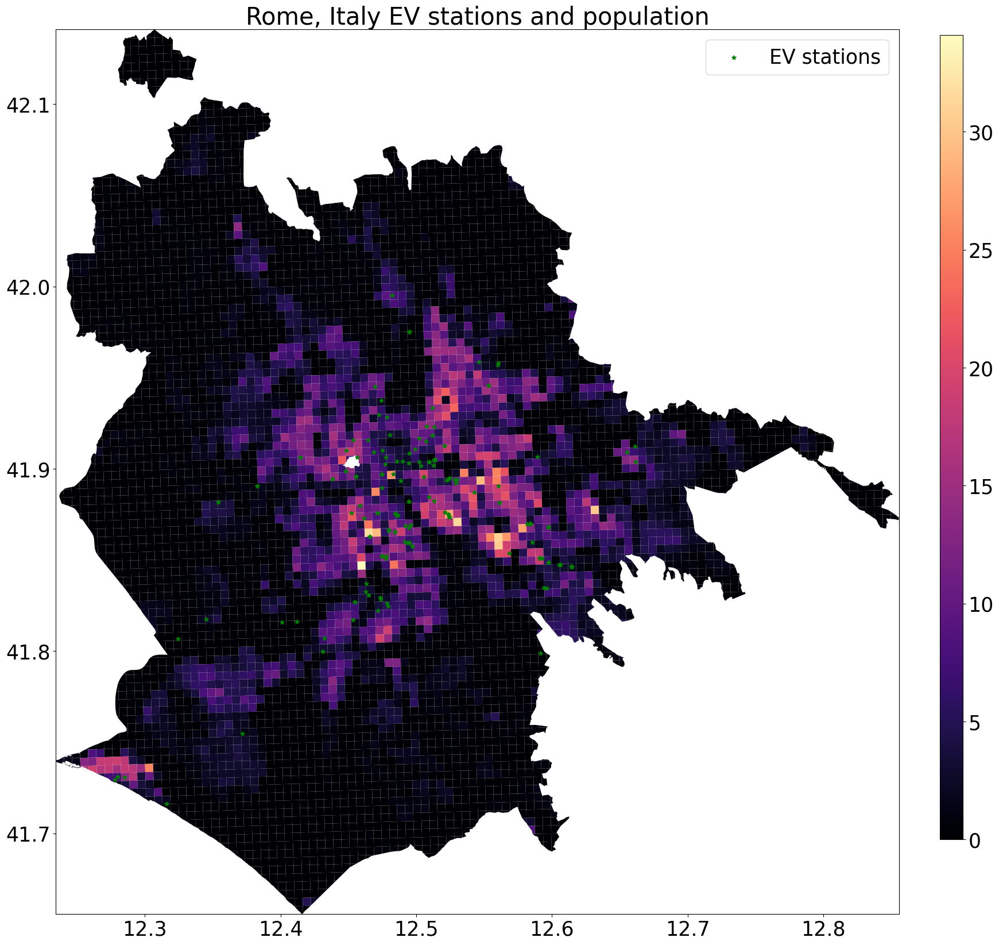

In [33]:
plt.rcParams.update({'font.size':25})
west, south, east, north = rome_polyframe_lat_long_new.unary_union.bounds

fig, ax = plt.subplots(figsize=(20,20))
rome_polyframe_lat_long_new.plot(ax=ax, column = 'population', legend=False, cmap='magma')
# add EV stations
EV_stations.plot(ax=ax, color='green', markersize=30, marker='*', label='EV stations')
# add legend
plt.legend(['EV stations'])
plt.title(f'{PLACE_NAME} EV stations and population')
cbax = fig.add_axes([0.915, 0.175, 0.02, 0.7])

sm = plt.cm.ScalarMappable(cmap='magma', \
                          norm = plt.Normalize(vmin=min(rome_polyframe_lat_long_new.population), vmax=max(rome_polyframe_lat_long_new.population)))
sm._A = []
# draw colormap into cbax
fig.colorbar(sm, cax=cbax, format="%d")
ax.set_xlim(west, east)
ax.set_ylim(south, north)
# ax.axis('off')30
plt.show()

## Land use

In [34]:
landuse = ox.geometries_from_place(PLACE_NAME, tags={'landuse': True})

# Define the categories
categories = {
    'residential': ['residential'],
    'commercial': ['commercial', 'retail', 'office', 'industrial'],
    'retail': ['retail'],
    'industrial': ['industrial']
}

# Create a new column to categorize the landuse types
landuse['category'] = 'Other'

# Iterate through the categories and assign the corresponding landuse types
for category, tags in categories.items():
    landuse.loc[landuse['landuse'].isin(tags), 'category'] = category

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_8156\4238397865.py:1: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in the v2.0.0 release. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  landuse = ox.geometries_from_place(PLACE_NAME, tags={'landuse': True})


In [52]:
landuse.to_csv(f"D:/charging_stations/task2/dataset/{name}-landuse.csv")

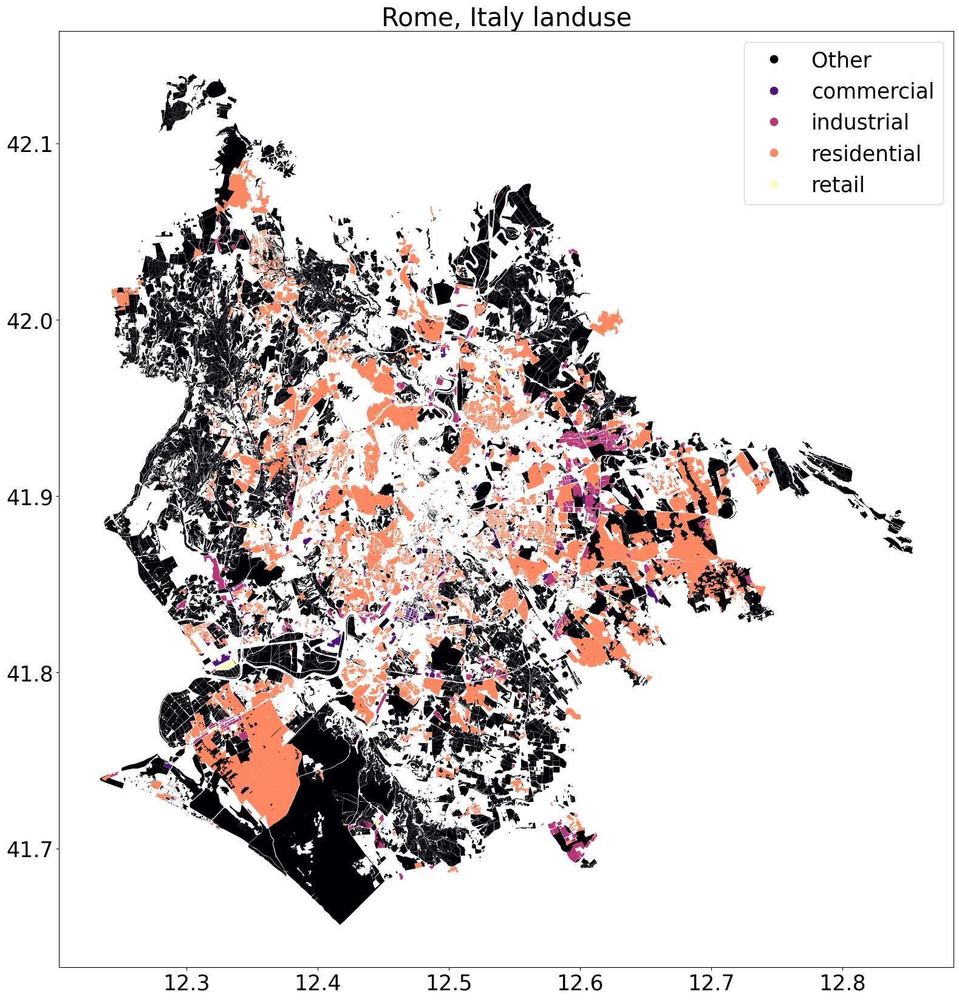

In [35]:
#plot node in landuse
fig, ax = plt.subplots(figsize=(20,20))
landuse.plot(ax=ax, column = 'category', legend=True, cmap='magma')
plt.title(f'{PLACE_NAME} landuse')
plt.show()

In [36]:
#create a copy of landuse drop everything except Category and geometry
landuse_cat = landuse[['category', 'geometry']].copy()

In [37]:
import shapely.speedups
shapely.speedups.enable()

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_8156\3808896212.py:2: DeprecationWarning: This function has no longer any effect, and will be removed in a future release. Starting with Shapely 2.0, equivalent speedups are always available
  shapely.speedups.enable()


In [38]:
masks_land_use = []
for i in tqdm(range(0,city_polyframe_lat_long.shape[0])):
    pip_mask = landuse_cat.within(city_polyframe_lat_long.loc[i, 'geometry']) 
    masks_land_use.append(pip_mask)
    assert pip_mask.shape[0] == landuse_cat.shape[0]

100%|██████████| 5649/5649 [00:05<00:00, 1107.20it/s]


In [39]:
land_labels = []
for i in range(0,city_polyframe_lat_long.shape[0]):
    if landuse_cat[masks_land_use[i]].category.value_counts().isnull().all() == True:
        land_labels.append('Other')
    else:
        land_labels.append(landuse_cat[masks_land_use[i]].category.value_counts().index[0])

In [40]:
rome_polyframe_lat_long_new['landuse'] = land_labels

In [41]:
rome_polyframe_lat_long_new.landuse.value_counts()

landuse
Other          5122
residential     407
industrial       83
commercial       26
retail           11
Name: count, dtype: int64

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_8156\3326680652.py:8: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()


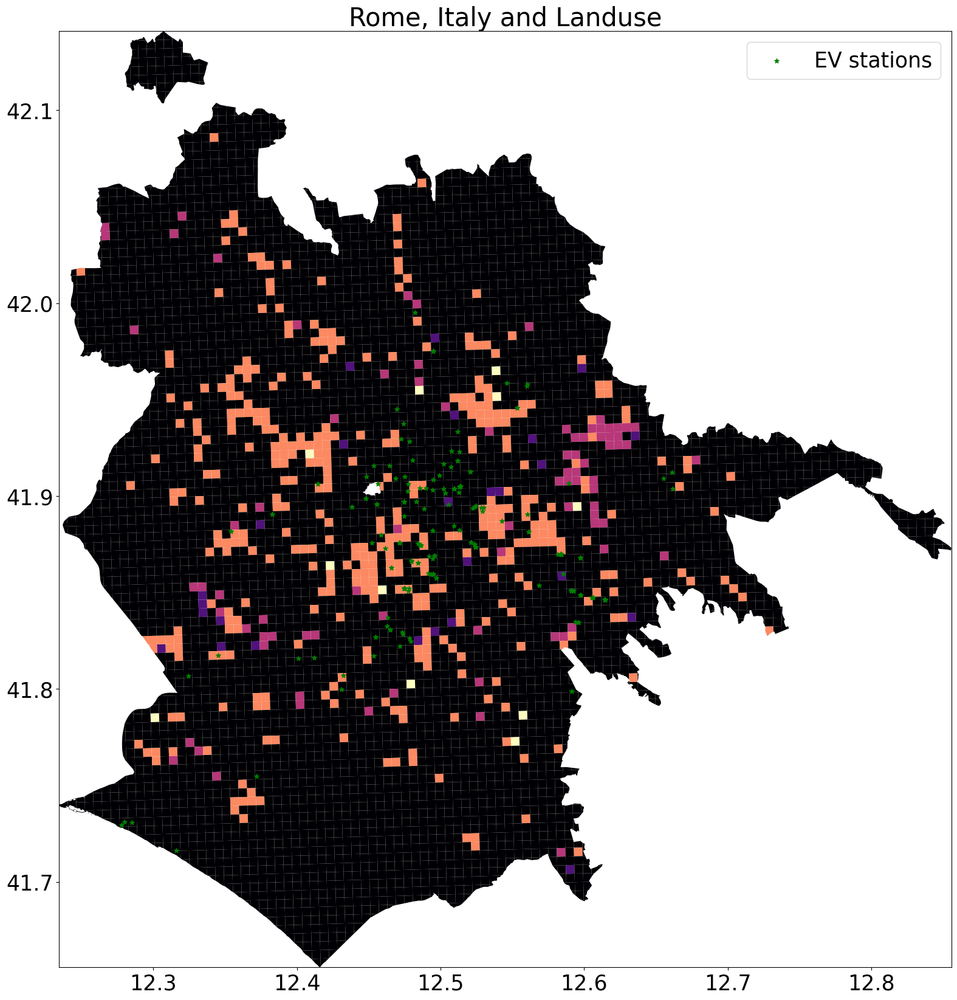

In [42]:
plt.rcParams.update({'font.size':25})
west, south, east, north = rome_polyframe_lat_long_new.unary_union.bounds

fig, ax = plt.subplots(figsize=(20,20))
rome_polyframe_lat_long_new.plot(ax=ax, column = 'landuse', legend=False, cmap='magma')
# add EV stations
EV_stations.plot(ax=ax, color='green', markersize=30, marker='*', label='EV stations')
ax.legend()
# add legend
plt.title(f'{PLACE_NAME} and Landuse')
ax.set_xlim(west, east)
ax.set_ylim(south, north)
# ax.axis('off')30
plt.show()

In [43]:
rome_polyframe_lat_long_new.head()

,geometry,EV_stations_counts,EV_stations_geomery,population,landuse
0,"POLYGON ((12.23447 41.74005, 12.23519 41.74020...",0,[],1.876362,Other
1,"POLYGON ((12.23808 41.74102, 12.23815 41.74106...",0,[],1.394988,Other
2,"POLYGON ((12.24035 41.74182, 12.24043 41.74184...",0,[],1.531297,Other
3,"POLYGON ((12.24633 41.74122, 12.24646 41.73832...",0,[],1.561379,Other
4,"POLYGON ((12.24468 41.73671, 12.24474 41.73667...",0,[],0.000000,Other


## Road Connectivity

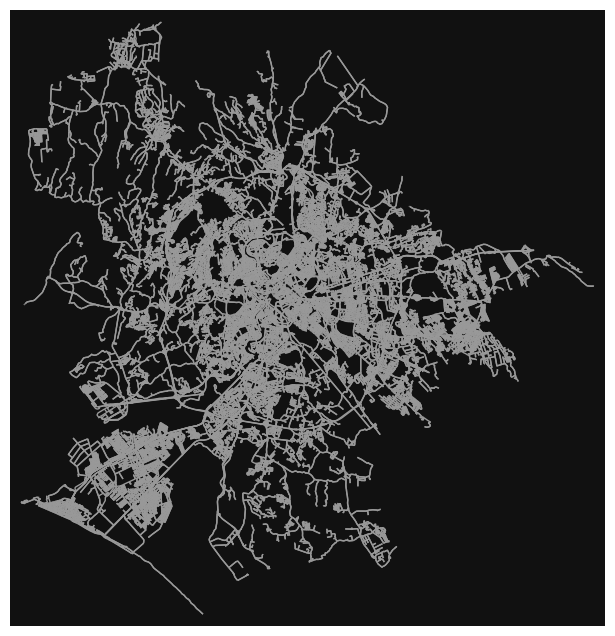

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [44]:
G = ox.graph_from_place(PLACE_NAME, network_type='drive')
ox.plot_graph(G, node_size= 0)

In [45]:
area,edges = ox.graph_to_gdfs(G)

In [46]:
#calculate number of edges and nodes for each grid
nodes = []
edges = []
density = []
for i in tqdm(range(0,city_polyframe_lat_long.shape[0])):
    try: 
        poly = city_polyframe_lat_long.loc[i, 'geometry']
        G = ox.graph_from_polygon(poly, network_type='drive')
        nodes.append(len(list(G.nodes())))
        edges.append(len(list(G.edges())))
        density.append(nx.density(G))
    except:
        nodes.append(0)
        edges.append(0)
        density.append(0)

100%|██████████| 5649/5649 [2:01:01<00:00,  1.29s/it]   


In [47]:
#add nodes, edges and density to the dataframe
rome_polyframe_lat_long_new['nodes'] = nodes
rome_polyframe_lat_long_new['edges'] = edges
rome_polyframe_lat_long_new['density'] = density

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_13136\3496988589.py:12: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()


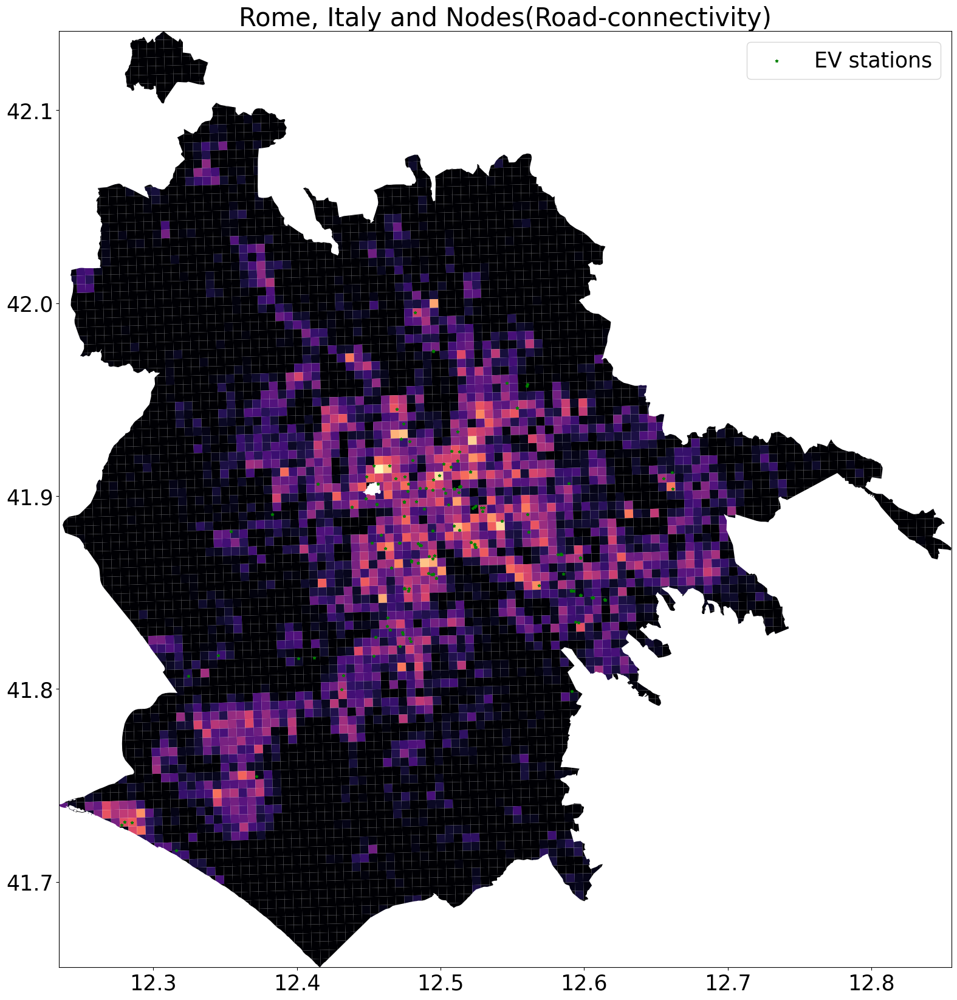

In [104]:
# relation between EVCSs and nodes
plt.rcParams.update({'font.size':25})
west, south, east, north = rome_polyframe_lat_long_new.unary_union.bounds

#nodes
fig, ax = plt.subplots(figsize=(20,20))
rome_polyframe_lat_long_new.plot(ax=ax, column = 'nodes', legend=False, cmap='magma')

# add EV stations
EV_stations.plot(ax=ax, color='green', markersize=10, marker='*', label='EV stations')

ax.legend()
plt.title(f'{PLACE_NAME} and Nodes(Road-connectivity)')
ax.set_xlim(west, east)
ax.set_ylim(south, north)
plt.show()

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_13136\843479457.py:11: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()


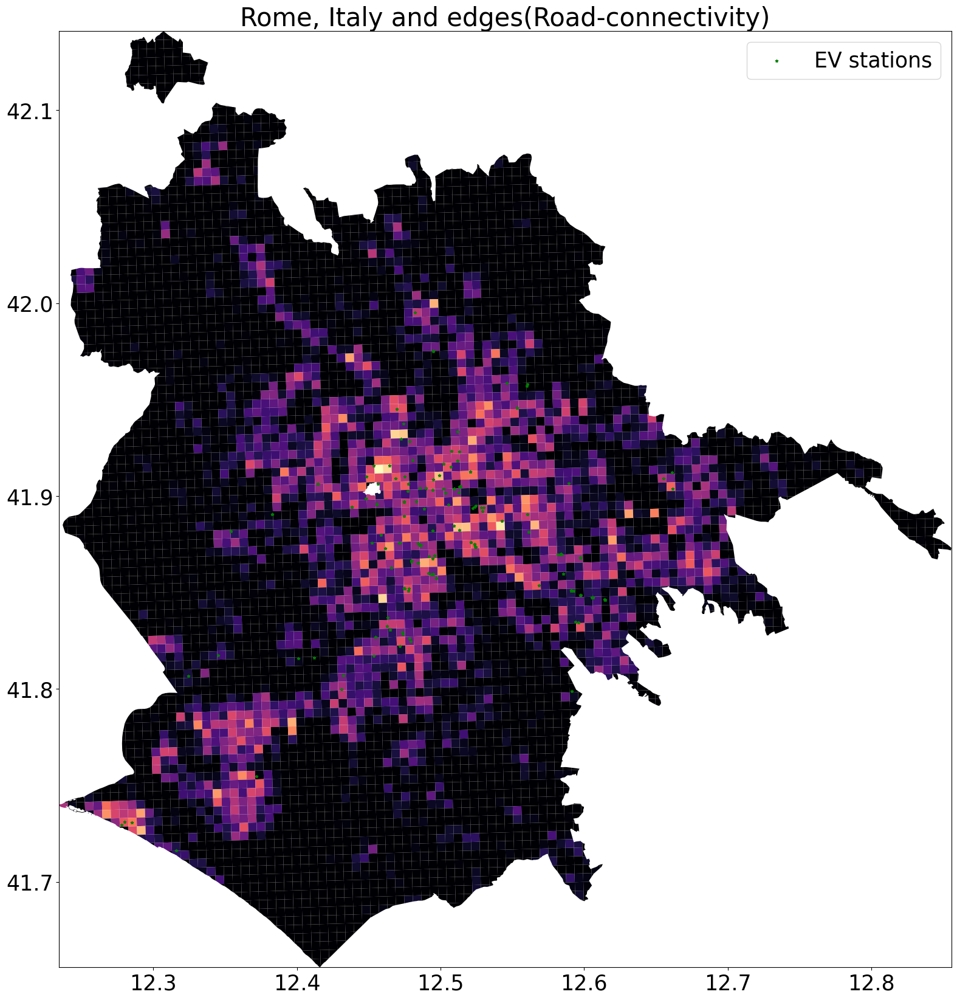

In [105]:
plt.rcParams.update({'font.size':25})
west, south, east, north = rome_polyframe_lat_long_new.unary_union.bounds

#edges
fig, ax = plt.subplots(figsize=(20,20))
rome_polyframe_lat_long_new.plot(ax=ax, column = 'edges', legend=False, cmap='magma')

# add EV stations
EV_stations.plot(ax=ax, color='green', markersize=10, marker='*', label='EV stations')

ax.legend()
plt.title(f'{PLACE_NAME} and edges(Road-connectivity)')
ax.set_xlim(west, east)
ax.set_ylim(south, north)
plt.show()

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_13136\25415402.py:11: UserWarning: Legend does not support handles for PatchCollection instances.
See: https://matplotlib.org/stable/tutorials/intermediate/legend_guide.html#implementing-a-custom-legend-handler
  ax.legend()


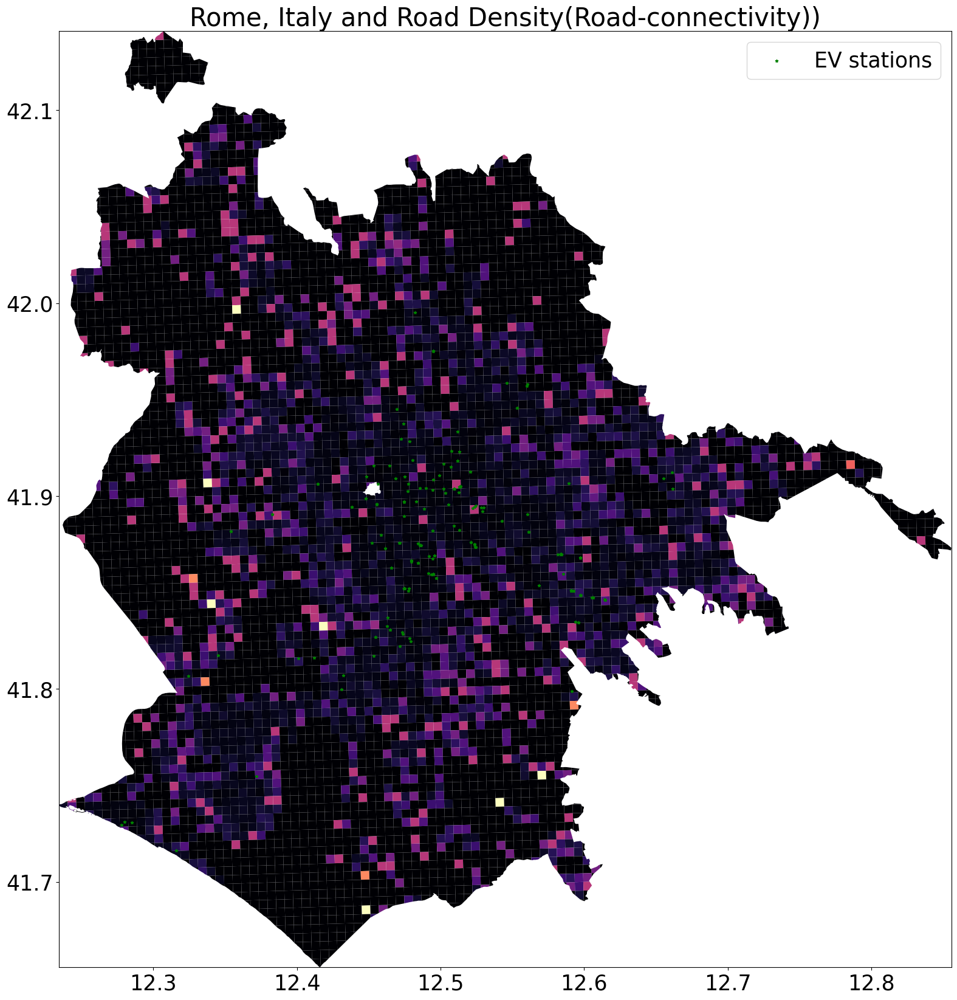

In [106]:
plt.rcParams.update({'font.size':25})
west, south, east, north = rome_polyframe_lat_long_new.unary_union.bounds

#density
fig, ax = plt.subplots(figsize=(20,20))
rome_polyframe_lat_long_new.plot(ax=ax, column = 'density', legend=False, cmap='magma')

# add EV stations
EV_stations.plot(ax=ax, color='green', markersize=10, marker='*', label='EV stations')

ax.legend()
plt.title(f'{PLACE_NAME} and Road Density(Road-connectivity))')
ax.set_xlim(west, east)
ax.set_ylim(south, north)
plt.show()

In [48]:
rome_polyframe_lat_long_new.head()

,geometry,EV_stations_counts,EV_stations_geomery,population,landuse,nodes,edges,density
0,"POLYGON ((12.23447 41.74005, 12.23519 41.74020...",0,[],1.876362,Other,21,58,0.138095
1,"POLYGON ((12.23808 41.74102, 12.23815 41.74106...",0,[],1.394988,Other,0,0,0.000000
2,"POLYGON ((12.24035 41.74182, 12.24043 41.74184...",0,[],1.531297,Other,2,2,1.000000
3,"POLYGON ((12.24633 41.74122, 12.24646 41.73832...",0,[],1.561379,Other,4,6,0.500000
4,"POLYGON ((12.24468 41.73671, 12.24474 41.73667...",0,[],0.000000,Other,0,0,0.000000


## POIs

In [49]:
import osmnx as ox
import pandas as pd
from tqdm import tqdm

def count_features_in_grids(place_name, features, city_polyframe, dataframe_name):
    for feature_key, feature_list in features.items():
        for feature in feature_list:
            try:
                # Fetch geometries from OpenStreetMap
                geometries = ox.geometries_from_place(
                    place_name,
                    {feature_key: feature}
                )
                # Export to CSV if geometries are found
                if not geometries.empty:
                    geometries.to_csv(f"D:/charging_stations/task2/dataset/Rome-{feature}.csv")

                    # Create masks for each grid
                    masks = []
                    for i in tqdm(range(0, city_polyframe.shape[0]), desc=f"Processing masks for {feature}"):
                        pip_mask = geometries.within(city_polyframe.loc[i, 'geometry'])
                        masks.append(pip_mask)

                    # Count features in each grid
                    feature_counts = []
                    for i in tqdm(range(0, city_polyframe.shape[0]), desc=f"Counting {feature}"):
                        feature_counts.append(geometries[masks[i]].shape[0])

                    # Add counts to the dataframe
                    dataframe_name[f'{feature}_count'] = feature_counts
                else:
                    print(f"No data found for {feature_key}='{feature}' in {place_name}.")
            except Exception as e:
                print(f"Failed to process {feature_key}='{feature}' in {place_name}: {str(e)}")

In [50]:
features = {
    'amenity': ['school', 'university', 'restaurant', 'place_of_worship', 
                'community_centre', 'townhall', 'parking', 'library'],
    'leisure': ['park', 'cinema'],
    'building': ['commercial', 'government', 'civic', 'retail']
}

city_polyframe = rome_polyframe_lat_long_new

count_features_in_grids(PLACE_NAME, features, city_polyframe, rome_polyframe_lat_long_new)

C:\Users\LENOVO\AppData\Local\Temp\ipykernel_8156\3074200968.py:10: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in the v2.0.0 release. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  geometries = ox.geometries_from_place(
Counting school: 100%|██████████| 5649/5649 [00:01<00:00, 3719.19it/s]
C:\Users\LENOVO\AppData\Local\Temp\ipykernel_8156\3074200968.py:10: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in the v2.0.0 release. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  geometries = ox.geometries_from_place(
Counting university: 

Failed to process leisure='cinema' in Rome, Italy: No data elements in server response. Check log and query location/tags.


C:\Users\LENOVO\AppData\Local\Temp\ipykernel_8156\3074200968.py:10: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in the v2.0.0 release. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  geometries = ox.geometries_from_place(
Counting commercial: 100%|██████████| 5649/5649 [00:03<00:00, 1752.64it/s]
C:\Users\LENOVO\AppData\Local\Temp\ipykernel_8156\3074200968.py:10: FutureWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in the v2.0.0 release. See the OSMnx v2 migration guide: https://github.com/gboeing/osmnx/issues/1123
  geometries = ox.geometries_from_place(
Counting governme

In [51]:
rome_polyframe_lat_long_new.head().T

,0,1,2,3,4
geometry,"POLYGON ((12.2344669 41.740046099999994, 12.23...",POLYGON ((12.238081281163069 41.74102481112229...,POLYGON ((12.240350100061367 41.74181902017413...,POLYGON ((12.246334913662437 41.74122305606923...,"POLYGON ((12.24468216472142 41.73670731642376,..."
EV_stations_counts,0,0,0,0,0
EV_stations_geomery,[],[],[],[],[]
population,1.876362,1.394988,1.531297,1.561379,0.0
landuse,Other,Other,Other,Other,Other
nodes,21,0,2,4,0
edges,58,0,2,6,0
density,0.138095,0.0,1.0,0.5,0.0
school_count,0,0,0,0,0
university_count,0,0,0,0,0


## Traffic

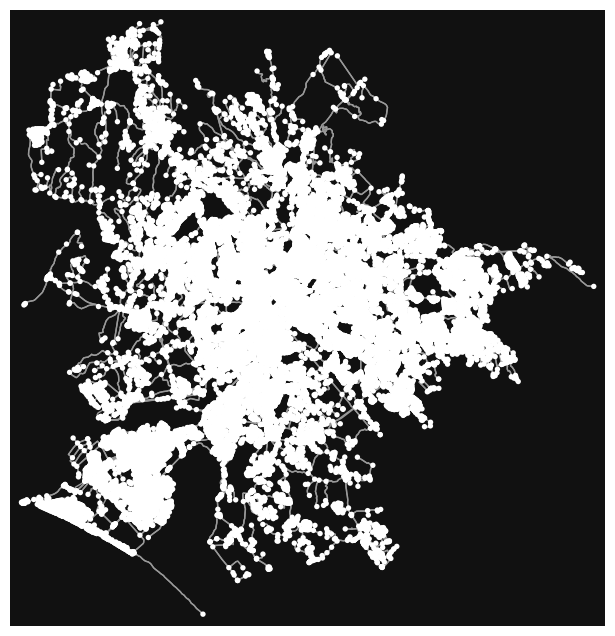

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [55]:
# Fetch road network data
rome_graph = ox.graph_from_place(PLACE_NAME, network_type='drive')

# Visualize the road network
ox.plot_graph(rome_graph)

In [56]:
# Convert the graph to edge GeoDataFrame
edges = ox.graph_to_gdfs(rome_graph, nodes=False, edges=True)

In [59]:
selected_columns = edges[['osmid', 'oneway', 'lanes', 'highway', 'maxspeed', 
                          'geometry']]

In [60]:
selected_columns.head()

osmid  \
u        v         key                                                      
21637960 347298954 0                                             31236071   
         286433005 0    [55216677, 55216678, 71970279, 31236076, 23051...   
21638011 370042353 0                                              5190200   
         366164457 0                                            164681852   
21638013 366169231 0                                             32848467   

                        oneway lanes      highway maxspeed  \
u        v         key                                       
21637960 347298954 0      True     2    secondary       50   
         286433005 0     False     2    secondary       50   
21638011 370042353 0     False     2     tertiary       30   
         366164457 0      True     1     tertiary      NaN   
21638013 366169231 0     False   NaN  residential       50   

                                                                 geometry  
u        v         key                                                     
21637960 347298954 0    LINESTRING (12.34836 41.70211, 12.34828 41.702...  
         286433005 0    LINESTRING (12.34836 41.70211, 12.34850 41.702...  
21638011 370042353 0    LINESTRING (12.26403 41.73374, 12.26393 41.733...  
         366164457 0    LINESTRING (12.26403 41.73374, 12.26407 41.733...  
21638013 366169231 0    LINESTRING (12.26868 41.73226, 12.26913 41.73304)

In [61]:
# Drop rows where any cell in that row is NA
selected_columns = selected_columns.dropna()

In [66]:
# Convert road network to a projected CRS
road_network = selected_columns.to_crs(epsg=32633)

# Also ensure your polygons are in the same CRS
rome_polyframe_lat_long_new = rome_polyframe_lat_long_new.to_crs(epsg=32633)

In [67]:
# Calculate centroids safely
road_centers = road_network.centroid

In [68]:
def check_one_way(polygon, roads):
    # Recalculate centroids here if necessary
    road_centers = roads.centroid  # Ensure 'roads' is already in a projected CRS
    within_mask = road_centers.within(polygon)
    one_way_roads = roads[within_mask & roads['oneway']]
    return 'Yes' if not one_way_roads.empty else 'No'

# Apply the function
rome_polyframe_lat_long_new['oneway_exists'] = rome_polyframe_lat_long_new['geometry'].apply(check_one_way, roads=road_network)

In [69]:
rome_polyframe_lat_long_new.head().T

,0,1,2,3,4
geometry,"POLYGON ((270025.0236539849 4624611.065670625,...","POLYGON ((270329.1039278301 4624710.079976299,...",POLYGON ((270520.61736074375 4624792.210253496...,"POLYGON ((271016.2110675025 4624710.079976298,...",POLYGON ((270862.6974666065 4624213.0613727905...
EV_stations_counts,0,0,0,0,0
EV_stations_geomery,[],[],[],[],[]
population,1.876362,1.394988,1.531297,1.561379,0.0
landuse,Other,Other,Other,Other,Other
nodes,21,0,2,4,0
edges,58,0,2,6,0
density,0.138095,0.0,1.0,0.5,0.0
school_count,0,0,0,0,0
university_count,0,0,0,0,0


In [72]:
def check_highways(polygon, roads):
    # Calculate centroids for the roads and check if they fall within the given polygon
    road_centers = roads.centroid
    within_mask = road_centers.within(polygon)
    highways_within = roads.loc[within_mask, 'highway']

    # Flatten the list of highways if they are stored in lists within cells
    flattened_highways = []
    for item in highways_within.dropna():
        if isinstance(item, list):
            flattened_highways.extend(item)  # Extend the flat list with elements of the sublist
        else:
            flattened_highways.append(item)  # Append the item directly if it's not a list

    # Create a set of unique highway types, removing duplicates and handling unhashable types
    unique_highways = set(flattened_highways)
    return unique_highways if unique_highways else 'None'

In [73]:
rome_polyframe_lat_long_new['highway_types'] = rome_polyframe_lat_long_new['geometry'].apply(check_highways, roads=road_network)

In [74]:
rome_polyframe_lat_long_new.head().T

,0,1,2,3,4
geometry,"POLYGON ((270025.0236539849 4624611.065670625,...","POLYGON ((270329.1039278301 4624710.079976299,...",POLYGON ((270520.61736074375 4624792.210253496...,"POLYGON ((271016.2110675025 4624710.079976298,...",POLYGON ((270862.6974666065 4624213.0613727905...
EV_stations_counts,0,0,0,0,0
EV_stations_geomery,[],[],[],[],[]
population,1.876362,1.394988,1.531297,1.561379,0.0
landuse,Other,Other,Other,Other,Other
nodes,21,0,2,4,0
edges,58,0,2,6,0
density,0.138095,0.0,1.0,0.5,0.0
school_count,0,0,0,0,0
university_count,0,0,0,0,0


In [77]:
def aggregate_lanes(polygon, roads):
    road_centers = roads.centroid
    within_mask = road_centers.within(polygon)
    lanes_within = roads.loc[within_mask, 'lanes'].dropna()
    # Convert data to numeric, because 'lanes' might be stored as strings
    lanes_within = pd.to_numeric(lanes_within, errors='coerce')
    return lanes_within.mean()  # You could also consider sum, max, or other aggregations

In [78]:
rome_polyframe_lat_long_new['average_lanes'] = rome_polyframe_lat_long_new['geometry'].apply(aggregate_lanes, roads=road_network)

In [79]:
def aggregate_maxspeed(polygon, roads):
    road_centers = roads.centroid
    within_mask = road_centers.within(polygon)
    maxspeed_within = roads.loc[within_mask, 'maxspeed'].dropna()
    
    # Process each maxspeed entry, whether list or string, to get numeric values
    def process_maxspeed_entry(entry):
        if isinstance(entry, list):
            # Assuming the list has a string with the first element as the speed
            return pd.to_numeric(entry[0].split(' ')[0], errors='coerce')
        elif isinstance(entry, str):
            return pd.to_numeric(entry.split(' ')[0], errors='coerce')
        else:
            return pd.NA  # Pandas' NA for missing type-aware handling

    # Apply processing function to each item in the series
    maxspeed_numeric = maxspeed_within.apply(process_maxspeed_entry)
    return maxspeed_numeric.mean()  # Calculate mean of the cleaned, numeric maxspeed values

In [80]:
rome_polyframe_lat_long_new['average_maxspeed'] = rome_polyframe_lat_long_new['geometry'].apply(aggregate_maxspeed, roads=road_network)

In [81]:
rome_polyframe_lat_long_new.head().T

,0,1,2,3,4
geometry,"POLYGON ((270025.0236539849 4624611.065670625,...","POLYGON ((270329.1039278301 4624710.079976299,...",POLYGON ((270520.61736074375 4624792.210253496...,"POLYGON ((271016.2110675025 4624710.079976298,...",POLYGON ((270862.6974666065 4624213.0613727905...
EV_stations_counts,0,0,0,0,0
EV_stations_geomery,[],[],[],[],[]
population,1.876362,1.394988,1.531297,1.561379,0.0
landuse,Other,Other,Other,Other,Other
nodes,21,0,2,4,0
edges,58,0,2,6,0
density,0.138095,0.0,1.0,0.5,0.0
school_count,0,0,0,0,0
university_count,0,0,0,0,0
